# COVID19 EDA - Trends and Outbreak Prediction of Spread in USA
 


## Project Title : COVID19 EDA - Trends and Outbreak Prediction of Spread in USA

### Name : Ragunath Gunasekaran

### Professor Name : Dr. Shankar Parajulee

### Course Name : DSC530-T302 Data Exploration and Analysis

#### Project Goal :  Develop COVID19 Data Tracker Tool with Key Performance Indicators (KPI), Trends, Geographic and Various visualizations, Prediction of CoronaVirus in the USA by using COVID19 Datasets and Python Programming Language.  

#### Project Purpose :  By using the  COVID19 Data Tracker , end users can see the current spread and future forecast details across the country along with various entities like Ethnicity, Geographic , Income Etc. Also COVID19 Data Tracker, will alert the end users with trends on Daily and Monthly Changes.

#### Research Questions : 

1. Daily Confirmed, new Confirmed and Death cases Analysis by Country, State, County

2. Predict the Corona Cases and Death 

3. State Level Counts of Corona virus, Comparison between States

4. Calculate Recovery and Death Rates, Deaths per 100k

5. Number of Corona Cases comparison : Positive vs Negative

6. Testing Count Details by Country, State, County

7.  Count of patients : Infected by Virus and Deaths

## Introduction: 

As of today, Corona cases in USA as below. 

1. Number of Cases - 11.8 M

2. Number of Deaths - 252K

The Analyses of current and future Spread is very important step in facing this pandemic situation.  This Analysis will help Government/Local bodies plan for the next steps.

##### Project Approaches:  

I am going to follow the below 4 steps in the Project. (Shown in below diagram below References)

1. Data Exploration

2. Data Cleaning and Preparation

3. Exploratory Data Analysis
        Confirmed vs Deaths Count Analysis - Scatter Plot
        US Death vs Death Rate Percentage
        PMF (Probability Mass function) - Death Rate Analysis by using Histogram
        CDF (Cumulative distribution function) - Confirmed Cases, Death Analysis
        Normal Probability - Mean, Standard Deviation Analysis
        PDF (probability density function) - Death Analysis with P-Values
        Correlation Verification - Confirmed Cases Vs Death Counts
        Confirmed vs Death cases with the Fitted line - Slope
        Hypothesis Test
        Linear Regression - Death vs Cases ( ordinary least squares )
        Logistic Regression Analysis of Death Rate with Confirmed, Death Cases
        Forecast using ARIMA Model
        Prediction of Confirmed Cases - ARIMA Model - Time Series Forecasting

4.  Conclusion

5.  References



## Datasets from NY Times and CDC Goverment website

https://aws.amazon.com/marketplace/pp/prodview-jmb464qw2yg74

https://www.cdc.gov/nchs/covid19/covid-19-mortality-data-files.htm


# Exploratory Data Analysis

### 1. Importing Python Packages and Libraries

In [559]:
# All Required Python Packages and Libraries - Import
import pandas as pd
import numpy as np
import seaborn as sns
from scipy.integrate import odeint
import scipy.stats as sp
import matplotlib.pyplot as plt
%matplotlib inline
import math
import bokeh 

from urllib.request import urlopen
import json

from dateutil import parser
from bokeh.layouts import gridplot
from bokeh.plotting import figure, show, output_file
from bokeh.layouts import row, column
from bokeh.resources import INLINE
from bokeh.io import output_notebook
from bokeh.models import Span
import warnings
warnings.filterwarnings("ignore")
output_notebook(resources=INLINE)

from __future__ import print_function, division
%matplotlib inline
import thinkstats2
import thinkplot

import statsmodels.formula.api as smf

#pip install pmdarima 
# Import the library 
from pmdarima import auto_arima
import datetime

from statsmodels.tsa.seasonal import seasonal_decompose

# Load specific evaluation tools 
from sklearn.metrics import mean_squared_error 
from statsmodels.tools.eval_measures import rmse 


Loading BokehJS ...

###  2.  Loading the data from Source file to Dataframe - Meta Data Verification

In [547]:
# Dataset preparation
# Downloaded the data files (.csv) from NY times Github location

# Data US Country Level
USCountry_DF = pd.read_csv('C:/Users/ragun/Documents/GitHub/dsc520-master/DS530-RGunasekaran/Final Project/us.csv', index_col ='date', parse_dates = True)

# Data US States Level
USStates_DF = pd.read_csv('C:/Users/ragun/Documents/GitHub/dsc520-master/DS530-RGunasekaran/Final Project/us-states.csv')

# Data US Counties Level
USCounties_DF = pd.read_csv('C:/Users/ragun/Documents/GitHub/dsc520-master/DS530-RGunasekaran/Final Project/us-counties.csv')

# Data World Level
World_DF = pd.read_csv('C:/Users/ragun/Documents/GitHub/dsc520-master/DS530-RGunasekaran/Final Project/covid_19_data.csv')


In [518]:
##### Converts dates to a specific format
# Removing the data with NA data
USCountry_DF.cases.dropna()
USStates_DF.deaths.dropna()

# Removing the data with NA data
USStates_DF.state.dropna()
USStates_DF.date.dropna()
USStates_DF.cases.dropna()
USStates_DF.deaths.dropna()

print(" ***************************************************************************************** ")
USCountry_DF.info()
print("Size/Shape of the Country Level dataset: ",USCountry_DF.shape)
print("Size/Shape of the State Level dataset: ",USStates_DF.shape)
print("Size/Shape of the Counties Level dataset: ",USCounties_DF.shape)
print(" ***************************************************************************************** ")
print("Checking for null values:\n",USCountry_DF.isnull().sum())
print("Checking Data-type of each column: Country Level \n",USCountry_DF.dtypes)
print(" ***************************************************************************************** ")
print("Checking Data-type of each column: State Level \n",USStates_DF.dtypes)
print(" ***************************************************************************************** ")
USStates_DF.info()
#Dropping column as SNo is of no use, and "Country" contains too many missing values
#USCountry_DF.drop(["SNo"],1,inplace=True)
print(" ***************************************************************************************** ")
USCounties_DF.info()

 ***************************************************************************************** 
<class 'pandas.core.frame.DataFrame'>
Index: 303 entries, 2020-11-18 to 2020-01-21
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   cases      303 non-null    int64  
 1   deaths     303 non-null    int64  
 2   fips       303 non-null    int64  
 3   DeathRate  303 non-null    float64
dtypes: float64(1), int64(3)
memory usage: 21.8+ KB
Size/Shape of the Country Level dataset:  (303, 4)
Size/Shape of the State Level dataset:  (14369, 5)
Size/Shape of the Counties Level dataset:  (745255, 6)
 ***************************************************************************************** 
Checking for null values:
 cases        0
deaths       0
fips         0
DeathRate    0
dtype: int64
Checking Data-type of each column: Country Level 
 cases          int64
deaths         int64
fips           int64
DeathRate    float64
dtype: object
 **

In [519]:
USStates_DF.head(20)

,date,state,fips,cases,deaths
0,2020-01-21,Washington,53,1,0
1,2020-01-22,Washington,53,1,0
2,2020-01-23,Washington,53,1,0
3,2020-01-24,Illinois,17,1,0
4,2020-01-24,Washington,53,1,0
5,2020-01-25,California,6,1,0
6,2020-01-25,Illinois,17,1,0
7,2020-01-25,Washington,53,1,0
8,2020-01-26,Arizona,4,1,0
9,2020-01-26,California,6,2,0


### 3. Summary Report - Confirmed Cases, Death Count at Date Level
            Created new column called Death Rate by considering death / Cases

In [505]:
# Summary Dataset Based on the Date - Group by

#pivot - rows into columns based on date
USCountry_DF = pd.pivot_table(USStates_DF, values=['cases','deaths','fips'], index='date', aggfunc='sum')

# death Rate calculation
USCountry_DF['DeathRate'] = round(USCountry_DF['deaths'] /USCountry_DF['cases'], 2)

# Summary Report based on the Confirmed Cases count order along colors to diffenrencitate the details
USCountry_DF = USCountry_DF.sort_values(by='cases', ascending= False)
USCountry_DF.style.background_gradient(cmap='YlOrRd')

,cases,deaths,fips,DeathRate
date,,,,
2020-11-18,11613875,250409,1762,0.020000
2020-11-17,11441484,248486,1762,0.020000
2020-11-16,11279747,246879,1762,0.020000
2020-11-15,11113482,246083,1762,0.020000
2020-11-14,10978295,245460,1762,0.020000
2020-11-13,10819174,244250,1762,0.020000
2020-11-12,10637603,242861,1762,0.020000
2020-11-11,10474163,241689,1762,0.020000
2020-11-10,10331303,240258,1762,0.020000


######  The above table shows the Confirmed cases and Death count at each date Level. On March 3rd,2020, we have seen the death rate is 8%. The above chart explains the Confirmed Cases, Death on each day. I have derived new variable called Death Rate which explains the percentage of death on that day when compared to Confirmed Cases.  On Feb 29,2020, we have seen first death recorded, hence the rate begins from that day.

### 4. US COVID Active Cases Graph

In [72]:
# Daily Case Count Graph
dailycases=USCountry_DF.groupby(["date"]).agg({"cases":'sum',"deaths":'sum'})
DailyCaseCount=px.bar(x=dailycases.index,y=dailycases["cases"]-dailycases["deaths"])
DailyCaseCount.update_layout(title="US COVID Active Cases Graph",
                  xaxis_title="Date",yaxis_title="Number of Cases",)
DailyCaseCount.show()

######  The above Chart shows that each day how the Corona cases confirmed. We can see that it's gradually increasing and as of November 18, the confirmed cases reached to 11 Million positive cases.
    

### 5. Confirmed & Deaths Count Analysis - Through Animation at State and Date Level

In this Chart is automated to play the video of Confirmed & Deaths Count Analysis at Date and State level. 

In [520]:


USDataframe = USStates_DF.groupby(["state", "date"])["cases", "deaths"].sum().reset_index()

plotUSDF = px.scatter(USDataframe, x="cases", y="deaths", animation_frame="date", animation_group="state",
           size="cases", color="state", hover_name="state",
           log_x=False, size_max=55, range_x=[0,550000], range_y=[-20,100000])

layout = go.Layout(
    title=go.layout.Title(
        text="Confirmed & Deaths in US states- Date",
        x=0.5
    ),
    font=dict(size=14),
    xaxis_title = "Total number of confirmed cases",
    yaxis_title = "Total number of death cases"
)

plotUSDF.update_layout(layout)

plotUSDF.show()

######  When I choose the Date 2020-09-19, we can see that New York State shows that 453747 as confirmed Cases, Death count as 32.67 K.

### 6. Confirmed vs Deaths Count Analysis - Scatter Plot

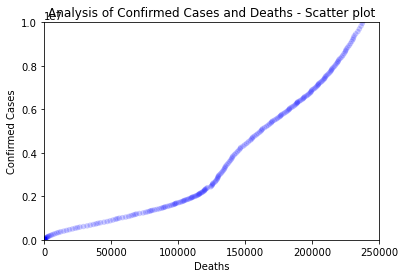

In [271]:
thinkplot.Scatter(USCountry_DF["deaths"], USCountry_DF["cases"])
thinkplot.Config(xlabel='Deaths',
                 ylabel='Confirmed Cases',
                 axis=[0, 250000,0,10000000], title= "Analysis of Confirmed Cases and Deaths - Scatter plot"
            )

######  The above Chart shows that each day how the Corona cases confirmed and Deaths happened in each state.

### 7. US Death vs Death Rate Percentage

In [194]:
deathrate=px.bar(x=USCountry_DF.index,y=USCountry_DF["Death Rate"])
deathrate.update_layout(title="US Death Rate Analysis",
                  xaxis_title="Date",yaxis_title="Death Rate in %",)
deathrate.show()


### 8. PMF (Probability Mass function) - Death Rate Analysis by using Histogram

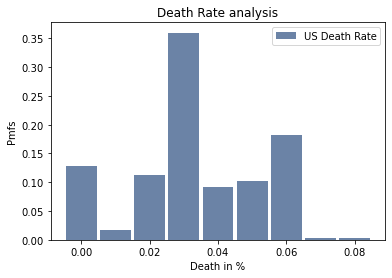

In [214]:
# Probability Mass Functions (PMF)
US_DeathRate=USCountry_DF["Death Rate"]

pmf = thinkstats2.Pmf(US_DeathRate, label='US Death Rate')

thinkplot.Hist(pmf)
thinkplot.Config(xlabel='Death in %', ylabel='Pmfs',title= "Death Rate analysis - PMF")

###### The Above Histogram shows that how death rates hapepend over the period of time

This diagram shows that death rate is decreaing from August. The more death rate is 0.08% and the death rate was stayed 100 days on 0.03%. 

### 9. CDF (Cumulative distribution function) - Confirmed Cases, Death Analysis

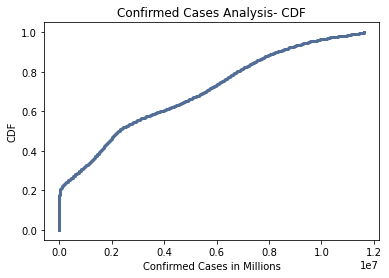

In [226]:
#  Cumulative Distribution Functions (CDF)
US_ConfirmedCases=USCountry_DF["cases"]

cdf_ConfirmedCases = thinkstats2.Cdf(US_ConfirmedCases)
thinkplot.Cdf(cdf_ConfirmedCases)
thinkplot.Config(xlabel='Confirmed Cases in Millions',
               ylabel='CDF',title= "Confirmed Cases Analysis- CDF")


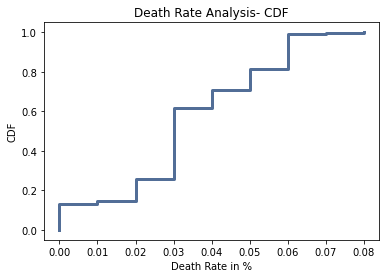

In [225]:
cdf_deathRate = thinkstats2.Cdf(US_DeathRate)
thinkplot.Cdf(cdf_deathRate)
thinkplot.Config(xlabel='Death Rate in %',
               ylabel='CDF',title= "Death Rate Analysis- CDF")


######  Cumulative Distribution Functions (CDF), we can see that 0.08% as peak and that consider as 1 or 100%, 

### 10. Normal Probability - Mean, Standard Deviation Analysis

In [237]:
mean, std = US_ConfirmedCases.mean(), US_ConfirmedCases.std()
print(" Here are the mean and standard deviation of Variables in the State Dataset ")
mean, std

 Here are the mean and standard deviation of Variables in the State Dataset 


(3460469.207920792, 3281429.5018072585)

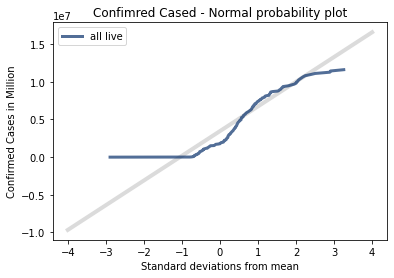

In [238]:
xs = [-4, 4]
fxs, fys = thinkstats2.FitLine(xs, mean, std)
thinkplot.Plot(fxs, fys, linewidth=4, color='0.8')

xs, ys = thinkstats2.NormalProbability(US_ConfirmedCases)
thinkplot.Plot(xs, ys, label='all live')

thinkplot.Config(title='Confimred Cases - Normal probability plot',
                 xlabel='Standard deviations from mean',
                 ylabel='Confirmed Cases in Million')

###### The Above curve shows that not normal distribution since the pdf object shows.

Mean of Datset - US State Level : Confirmed Cases - 72971.13 and Number of deaths - 2348.70

Standard Deviation of Datset - US State Level : Confirmed Cases - 135907.74 and Number of deaths - 4823.27

In [239]:
mean, std = USStates_DF.mean(), USStates_DF.std()
print(" Here are the mean and standard deviation of Variables in the State Dataset ")
mean, std

 Here are the mean and standard deviation of Variables in the State Dataset 


(fips         31.882038
 cases     72971.130211
 deaths     2348.709444
 dtype: float64,
 fips          18.624818
 cases     135907.744139
 deaths      4823.272479
 dtype: float64)

### 11. PDF (probability density function) - Death Analyis 

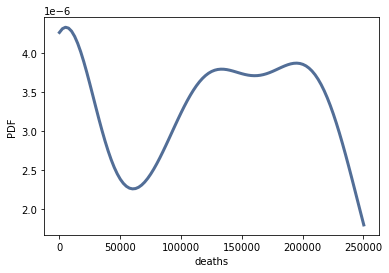

In [305]:
US_deaths=USCountry_DF["deaths"]

US_death = US_deaths.dropna()
pdf = thinkstats2.EstimatedPdf(US_death)
thinkplot.Pdf(pdf, label='deaths')
thinkplot.Config(xlabel='deaths', ylabel='PDF')


In [254]:
pdf = thinkstats2.NormalPdf(mean, std)
pdf.Density(mean + std)


array([1.29918438e-02, 1.78040424e-06, 5.01673346e-05])

In [255]:
y=np.array(USStates_DF['cases'].dropna().values, dtype=float)
x=np.array(pd.to_datetime(USStates_DF['date'].dropna()).index.values, dtype=float)
slope, intercept, r_value, p_value, std_err =sp.linregress(x,y)
xf = np.linspace(min(x),max(x),100)
xf1 = xf.copy()
xf1 = pd.to_datetime(xf1)
yf = (slope*xf)+intercept
print('r = ', r_value, '\n', 'p = ', p_value, '\n', 's = ', std_err)



r =  0.4197291503333768 
 p =  0.0 
 s =  0.24810084952424205


###### P values come as 0.0 for the dataset which shows that this dataset is statistically significant 
( I will verify this by using Hypothesis testing too )

### 12.  Correlation Verfication - Confirmed Cases Vs Death Counts

In [521]:
np.corrcoef(US_ConfirmedCases, US_deaths)

array([[1.       , 0.9569576],
       [0.9569576, 1.       ]])

###### The correlation coefficient matrix on the diagonal with 1 and 0.95 as self correlation.


### 13.  Confirmed vs Death cases with the Fitted line - Slope

In [285]:
from thinkstats2 import Mean, MeanVar, Var, Std, Cov

def LeastSquares(xs, ys):
    meanx, varx = MeanVar(xs)
    meany = Mean(ys)

    slope = Cov(xs, ys, meanx, meany) / varx
    inter = meany - slope * meanx

    return inter, slope

def FitLine(xs, inter, slope):
    fit_xs = np.sort(xs)
    fit_ys = inter + slope * fit_xs
    return fit_xs, fit_ys

In [286]:
inter, slope = LeastSquares(US_ConfirmedCases, US_deaths)
fit_xs, fit_ys = FitLine(US_ConfirmedCases, inter, slope)

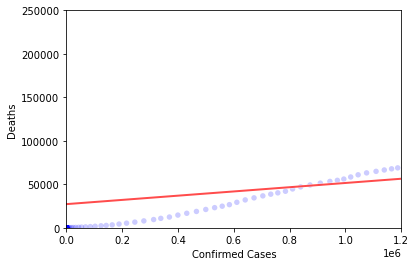

In [304]:
thinkplot.Scatter(US_ConfirmedCases, US_deaths, color='blue')
thinkplot.Plot(fit_xs, fit_ys, color='white', linewidth=3)
thinkplot.Plot(fit_xs, fit_ys, color='red', linewidth=2)
thinkplot.Config(xlabel="Confirmed Cases",
                 ylabel='Deaths',
                 axis=[0, 1200000, 0, 250000],
                 legend=False)

######  The Above graph shows the scatterplot of the confirmed vs death cases with the fitted line


### 14. HypothesisTest

In [309]:
class SlopeTest(thinkstats2.HypothesisTest):

    def TestStatistic(self, data):
        ages, weights = data
        _, slope = thinkstats2.LeastSquares(ages, weights)
        return slope

    def MakeModel(self):
        _, weights = self.data
        self.ybar = weights.mean()
        self.res = weights - self.ybar

    def RunModel(self):
        ages, _ = self.data
        weights = self.ybar + np.random.permutation(self.res)
        return ages, weights

In [310]:
ht = SlopeTest((US_ConfirmedCases, US_deaths))
pvalue = ht.PValue()
pvalue

0.0

######  This is reflecting our previous analysis at State Level data too. pvalue came as 0.0. Hence there is significant relation betwen cases confirmed with Death cases. ( I want to verify this eventhough we know this has significance )

### 15 . Linear Regression - Death vs Cases ( ordinary least squares )

In [327]:
# ordinary least squares.
model = smf.ols('deaths ~ cases', data=USCountry_DF)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 deaths   R-squared:                       0.916
Model:                            OLS   Adj. R-squared:                  0.915
Method:                 Least Squares   F-statistic:                     3272.
Date:                Sat, 21 Nov 2020   Prob (F-statistic):          9.24e-164
Time:                        11:59:58   Log-Likelihood:                -3488.0
No. Observations:                 303   AIC:                             6980.
Df Residuals:                     301   BIC:                             6987.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   2.722e+04   2025.927     13.436      0.000    2.32e+04    3.12e+04
cases          0.0243      0.000     57.205      0.000       0.023       0.025
==============================================================================
Omnibus:                      113.160   Durbin-Watson:                   0.001
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               16.715
Skew:                          -0.090   Prob(JB):                     0.000235
Kurtosis:                       1.864   Cond. No.                     6.93e+06
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 6.93e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

###### By using ordinary least squares model, R-squared Value from the model is 0.916 (91.6%) which shows that almost every confimred Cases can be explained by movements since 91.6% coefficient of determination.

###  16. Logistic Regression Analysis of Death Rate with Confirmed, Death Cases

In [352]:
formula='DeathRate ~ cases + deaths'
model = sm.Logit.from_formula(formula, USCountry_DF).fit()
print(model.summary())

Optimization terminated successfully.
         Current function value: 0.043430
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:              DeathRate   No. Observations:                  303
Model:                          Logit   Df Residuals:                      300
Method:                           MLE   Df Model:                            2
Date:                Sat, 21 Nov 2020   Pseudo R-squ.:                     inf
Time:                        12:17:18   Log-Likelihood:                -13.159
converged:                       True   LL-Null:                        0.0000
Covariance Type:            nonrobust   LLR p-value:                     1.000
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -3.8923      0.735     -5.299      0.000      -5.332      -2.453
cases      -4.392e-07   3.56e

In [353]:
t = model.pred_table()
print(t)
print("Accuracy:",np.diag(t).sum()/t.sum())

[[303.   0.]
 [  0.   0.]]
Accuracy: 1.0


###### By using Logistice Regression for death Rate, Accuracy of logistic regression for this data set is 1 which is 100%.

###  ETS ( Error, Trend, and Seasonality ) - of US Country Dataset:

In [442]:
result = seasonal_decompose(USCountry_DF['cases'],  
                            model ='multiplicative')

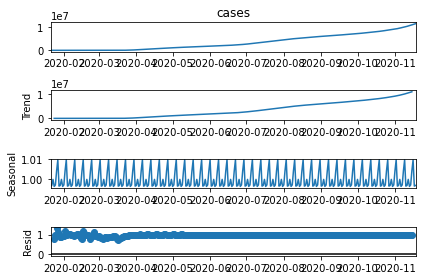

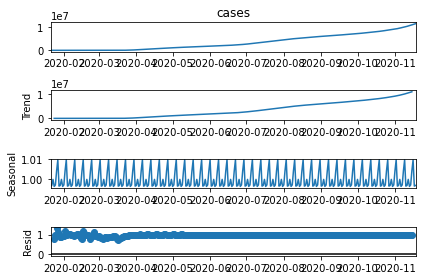

In [446]:
result.plot() 

### 16. Forecast using ARIMA Model

In [448]:
# Ignore harmless warnings 
import warnings 
warnings.filterwarnings("ignore") 
  
# Fit auto_arima function to US Country dataset 
stepwise_fit = auto_arima(USCountry_DF['cases'], start_p = 1, start_q = 1, 
                          max_p = 3, max_q = 3, m = 12, 
                          start_P = 0, seasonal = True, 
                          d = None, D = 1, trace = True, 
                          error_action ='ignore',   
                          suppress_warnings = True,   
                          stepwise = True)          
  
# show the the summaary of ARIMA output
stepwise_fit.summary() 

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,1,1)[12]             : AIC=inf, Time=1.29 sec
 ARIMA(0,2,0)(0,1,0)[12]             : AIC=6139.389, Time=0.02 sec
 ARIMA(1,2,0)(1,1,0)[12]             : AIC=6060.433, Time=0.28 sec
 ARIMA(0,2,1)(0,1,1)[12]             : AIC=inf, Time=0.64 sec
 ARIMA(1,2,0)(0,1,0)[12]             : AIC=6140.318, Time=0.04 sec
 ARIMA(1,2,0)(2,1,0)[12]             : AIC=6027.930, Time=0.70 sec
 ARIMA(1,2,0)(2,1,1)[12]             : AIC=5943.243, Time=3.69 sec
 ARIMA(1,2,0)(1,1,1)[12]             : AIC=6010.583, Time=0.37 sec
 ARIMA(1,2,0)(2,1,2)[12]             : AIC=inf, Time=5.94 sec
 ARIMA(1,2,0)(1,1,2)[12]             : AIC=6009.906, Time=1.76 sec
 ARIMA(0,2,0)(2,1,1)[12]             : AIC=5951.583, Time=3.71 sec
 ARIMA(2,2,0)(2,1,1)[12]             : AIC=5973.670, Time=1.98 sec
 ARIMA(1,2,1)(2,1,1)[12]             : AIC=5938.064, Time=5.62 sec
 ARIMA(1,2,1)(1,1,1)[12]             : AIC=6008.608, Time=0.78 sec
 ARIMA(1,2,1)(2,1,0)[12]          

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  303
Model:             SARIMAX(1, 2, 1)x(2, 1, 1, 12)   Log Likelihood               -2963.032
Date:                            Sat, 21 Nov 2020   AIC                           5938.064
Time:                                    13:26:31   BIC                           5960.062
Sample:                                         0   HQIC                          5946.878
                                            - 303                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2669      0.143      1.861      0.063      -0.014       0.548
ma.L1         -0.5200      0.116     -4.490      0.000      -0.747      -0.293
ar.S.L12      -0.2926      0.067     -4.344      0.000      -0.425      -0.161
ar.S.L24      -0.2575      0.089     -2.898      0.004      -0.432      -0.083
ma.S.L12      -0.8583      0.045    -18.979      0.000      -0.947      -0.770
sigma2      4.465e+07   1.76e-09   2.53e+16      0.000    4.47e+07    4.47e+07
===================================================================================
Ljung-Box (Q):                      401.01   Jarque-Bera (JB):               165.63
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):              18.81   Skew:                             0.55
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.54
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.64e+32. Standard errors may be unstable.
"""

###  17. Comparision of Prediction vs Actual

In [499]:
split_date = "2020-06-01"
df_train = df.loc[: split_date].copy() 
df_test = df.loc[split_date :].copy()


In [536]:
# Fit a SARIMAX(0, 1, 1)x(2, 1, 1, 12) on the training set 
from statsmodels.tsa.statespace.sarimax import SARIMAX 
  
model = SARIMAX(df_train['cases'],  
                order = (0, 1, 1),  
                seasonal_order =(2, 1, 1, 12)) 
  
SARIMAX_Result = model.fit() 
SARIMAX_Result.summary() 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                              cases   No. Observations:                  133
Model:             SARIMAX(0, 1, 1)x(2, 1, 1, 12)   Log Likelihood                -890.329
Date:                            Sat, 21 Nov 2020   AIC                           1790.658
Time:                                    16:11:09   BIC                           1804.595
Sample:                                01-21-2020   HQIC                          1796.318
                                     - 06-01-2020                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.9555      0.042     22.911      0.000       0.874       1.037
ar.S.L12       0.8213      0.070     11.762      0.000       0.684       0.958
ar.S.L24      -0.0516      0.086     -0.598      0.550      -0.221       0.117
ma.S.L12      -0.9975      0.118     -8.474      0.000      -1.228      -0.767
sigma2      1.471e+05   8.26e-07   1.78e+11      0.000    1.47e+05    1.47e+05
===================================================================================
Ljung-Box (Q):                      320.82   Jarque-Bera (JB):                17.62
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):          141213.01   Skew:                            -0.21
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.83
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.19e+26. Standard errors may be unstable.
"""

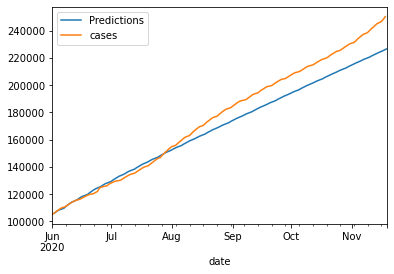

In [550]:
start = len(df_train) 
end = len(df_train) + len(df_test) - 1
  
# Predictions for one-year against the test set 
predictions = SARIMAX_Result.predict(start, end, 
                             typ = 'levels').rename("Predictions") 
  
# plot predictions and actual values 
predictions.plot(legend = True) 
df_test['cases'].plot(legend = True) 

######  The prediction count was 220 k but the real death count was 250K. Actually I have considered my training dataset up to Jun 1,2020. Based on that, we have seen the prediction was 220K but reality was little different since we have seen more deaths in July, Aug, Sept. 

In [532]:

# Calculate root mean squared error 
rmse(df_test["cases"], predictions) 
  
# Calculate mean squared error 
mean_squared_error(df_test["cases"], predictions) 

104651880.91971856

### 18 . Prediction of Confirmed Cases - ARIMA Model - Time Series Forecasting

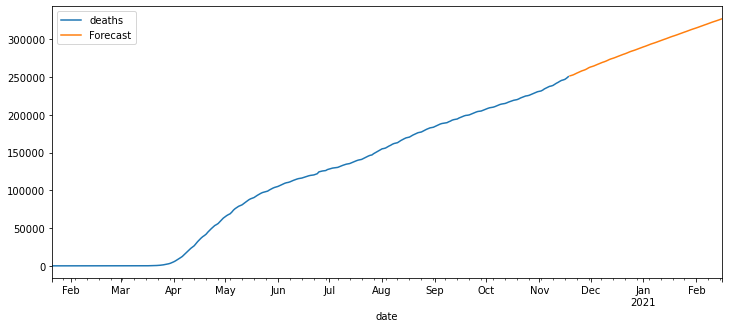

In [557]:
model = model = SARIMAX(USCountry_DF['deaths'],  
                        order = (0, 1, 1),  
                        seasonal_order =(2, 1, 1, 12)) 
result = model.fit() 
  
# Forecast for the next 3 months 
forecast = result.predict(start = len(USCountry_DF),  
                          end = (len(USCountry_DF)-1) + 6 * 15,  
                          typ = 'levels').rename('Forecast') 
  
# death count  
USCountry_DF['deaths'].plot(figsize = (12, 5), legend = True) 
forecast.plot(legend = True)

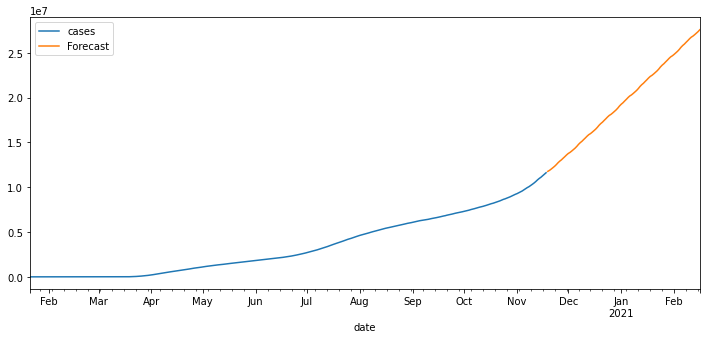

In [556]:
model = model = SARIMAX(USCountry_DF['cases'],  
                        order = (0, 1, 1),  
                        seasonal_order =(2, 1, 1, 12)) 
result = model.fit() 
  
# Forecast for the next 6 months 
forecast = result.predict(start = len(USCountry_DF),  
                          end = (len(USCountry_DF)-1) + 6 * 15,  
                          typ = 'levels').rename('Forecast') 
  
# Plot the forecast values 
USCountry_DF['cases'].plot(figsize = (12, 5), legend = True) 
forecast.plot(legend = True)

######  As part of the above prediction shows that by next year January, the death count may reach to around 290 K. 

## Conclusion

As part of this project, I have analyzed various techniques to perform the EDA of COVID19 Trends and Outbreak Prediction of Spread in USA.

The below are the outcomes of my EDA 

1. Calculated DeathRate Ratio - From Feb 29,2020 to Nov 18,2020, overall Death Count is 250K. Initially Death Ratio was increased and it started gradually decreasing from July,2020

2. Number of Death : Number of deaths is increasing day by day ( as of Nov 18 )

3. Confirmed Cases : Number of positive Count is increasing day by day ( as of Nov 18 ) - 11.61 M 

4. State Level Cases : Created Animation plot for State Level counts on daily basis. ( Both Confirmed and Death count )
   observed NY State count had highest counts.

5. Based on the Data as of Nov 18,2020, The prediction of Death count on January 31,2021 is 280K
    (If the same situation continuous, the count may reach more than 300K in Feb 2021)

6. Based on the Data as of Nov 18,2020, The prediction of Confirmed Cases count on January 31,2021 is 18 Million
    (If the same situation continuous, the count may reach more than 22 Million in Feb 2021)
    
The below are various techniques I used in this project to perform the Detailed EDA of COVID19 Trends and Outbreak Prediction of Spread in USA 

As of November 21,2020, We are hearing that vaccination is going to provided to people and I hope this will help to stop the COVID Spread and deaths.

My sincere Thanks to Professor Dr.Shankar Parajulee for all his guidance and support on this semester which helped me to perfume this detailed analysis of COVID Spread in USA.


## References:

1.  We’re Sharing Coronavirus Case Data for Every U.S. County by NY Times

        https://www.nytimes.com/article/coronavirus-county-data-us.html


2.  Coronavirus Disease 2019 (COVID-19)

        https://covid.cdc.gov/covid-data-tracker/?CDC_AA_refVal=https%3A%2F%2Fwww.cdc.gov%2Fcoronavirus%2F2019-ncov%2Fcases-             updates%2Fcases-in-us.html#cases_casesinlast7days


3.  Analyze NY Times Covid-19 Dataset, Medium

        https://towardsdatascience.com/analyze-ny-times-covid-19-dataset-86c802164210


4.  HOW TO USE DATA ANALYSIS FOR MACHINE LEARNING by Sharp Sight

        https://www.sharpsightlabs.com/blog/data-analysis-machine-learning-example-1/ 


5.  Python | ARIMA Model for Time Series Forecasting by geeksforgeeks

        https://www.geeksforgeeks.org/python-arima-model-for-time-series-forecasting/


6.  Modeling COVID-19 epidemic with Python Medium

        https://towardsdatascience.com/modeling-covid-19-epidemic-with-python-bed21b8f6baf